# Mean Variance Optimization

You are an investment analyst at a large fund. You specialize in calculating efficient frontiers and selecting assets for portfolios.

This project is split into three tasks, each with its own Python file:

* Follow the steps to calculate the efficient frontier of a portfolio with five assets (`script1.py`)
* See how two additional assets affect the efficient frontier from part one (`script2.py`)
* Use the covariance matrix and expected returns from ten assets to select the five assets that produce the best efficient frontier (`script3.py`)

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from rf import return_portfolios, optimal_portfolio
import numpy as np

## Task One: `script1.py`

1. Load `stock_data_weak.csv` file as a DataFrame and save it to a variable called `stock_data`.

    Use `print(stock_data)` to visualize the data.

In [2]:
stock_data = pd.read_csv('stock_data_weak.csv')
stock_data

,Date,General Electric,Chesapeake Energy,AT&T,Cisco Systems,Campbell Soup
0,2007-12-31,37.08,39.36,42.12,27.25,35.77
1,2008-03-31,36.63,45.76,37.71,24.08,33.91
2,2008-06-30,26.35,66.77,32.75,23.47,33.03
3,2008-09-30,23.87,33.29,28.35,22.25,38.30
4,2008-12-31,15.82,15.34,28.19,16.18,29.49
5,2009-03-31,10.33,17.65,25.44,16.53,27.03
6,2009-06-30,11.84,19.72,25.14,18.94,29.66
7,2009-09-30,16.83,28.80,27.34,23.55,32.94
8,2009-12-31,15.27,26.36,28.29,24.10,34.14
9,2010-03-31,18.21,23.52,25.90,26.52,35.25


2. Find the quarterly returns over each period for all assets in `stock_data`. Save the result to `returns_quarterly`.

In [3]:
quarterly_returns = stock_data[stock_data.columns[1:]].pct_change()
quarterly_returns

,General Electric,Chesapeake Energy,AT&T,Cisco Systems,Campbell Soup
0,NaN,NaN,NaN,NaN,NaN
1,-0.012136,0.162602,-0.104701,-0.116330,-0.051999
2,-0.280644,0.459135,-0.131530,-0.025332,-0.025951
3,-0.094118,-0.501423,-0.134351,-0.051981,0.159552
4,-0.337243,-0.539201,-0.005644,-0.272809,-0.230026
5,-0.347029,0.150587,-0.097552,0.021632,-0.083418
6,0.146176,0.117280,-0.011792,0.145796,0.097299
7,0.421453,0.460446,0.087510,0.243400,0.110587
8,-0.092692,-0.084722,0.034748,0.023355,0.036430
9,0.192534,-0.107739,-0.084482,0.100415,0.032513


3. Find the expected return for each asset and save the result to `expected_returns`.

In [4]:
expected_returns = quarterly_returns.mean()
expected_returns

General Electric    -0.012048
Chesapeake Energy   -0.030608
AT&T                -0.001464
Cisco Systems        0.018479
Campbell Soup        0.008469
dtype: float64

4. Find the covariance of the quarterly returns over each period and save the result to `cov_quarterly`.

In [5]:
cov_quarterly = quarterly_returns.cov()
cov_quarterly

,General Electric,Chesapeake Energy,AT&T,Cisco Systems,Campbell Soup
General Electric,0.026007,0.010742,0.007080,0.006391,0.007467
Chesapeake Energy,0.010742,0.056647,0.002392,0.006528,0.001770
AT&T,0.007080,0.002392,0.006458,0.000735,0.002638
Cisco Systems,0.006391,0.006528,0.000735,0.012877,0.002787
Campbell Soup,0.007467,0.001770,0.002638,0.002787,0.008942


5. We loaded the function `return_portfolios()` from `rf.py`, which accepts the expected return and quarterly covariance of a set of assets and returns a random collection of 5,000 portfolios. The return is formatted as a DataFrame with columns: `'Volatility'` and `'Returns'`.

    Use the expected returns and covariances to find a set of random portfolios. Save the result to `random_portfolios`.

In [6]:
random_portfolios = return_portfolios(expected_returns, cov_quarterly)
random_portfolios.head(4)

,Returns,Volatility,General Electric Weight,Chesapeake Energy Weight,AT&T Weight,Cisco Systems Weight,Campbell Soup Weight
0,0.006978,0.078130,0.125694,0.024182,0.123977,0.326042,0.400106
1,-0.000340,0.086977,0.232733,0.122589,0.166200,0.240491,0.237986
2,-0.005051,0.099078,0.217007,0.235888,0.266876,0.279798,0.000430
3,-0.008423,0.098457,0.194715,0.267544,0.309456,0.063131,0.165153


6. Plot the random portfolios.

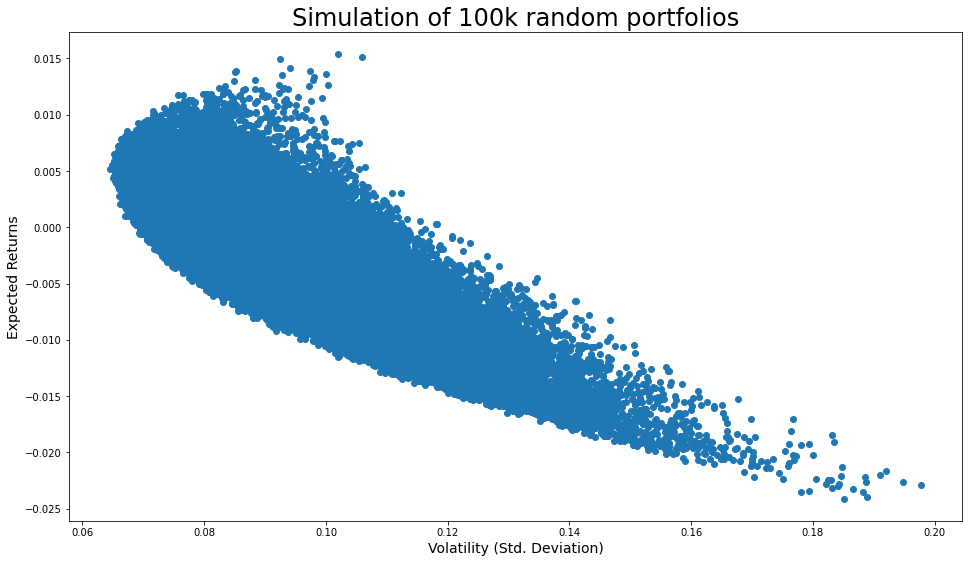

In [7]:
plt.figure(figsize=(16,9))
plt.scatter(random_portfolios['Volatility'], random_portfolios['Returns'])
plt.ylabel('Expected Returns',fontsize=14)
plt.xlabel('Volatility (Std. Deviation)',fontsize=14)
plt.title('Simulation of 100k random portfolios', fontsize=24)
plt.show()

7. We loaded the function `optimal_portfolio()` from `rf.py`, which accepts the quarterly returns of a set of assets. The function returns the `weights`, `returns`, and `risks` of portfolios on the efficient frontiers. The returns are formatted as NumPy arrays.

    Use the `optimal_portfolio()` function to calculate the `weights`, `returns`, and `risks` of portfolios on the efficient frontier.

In [8]:
weights, returns, risks = optimal_portfolio(quarterly_returns[1:])

8. Plot the efficient frontier as a yellow line, with dots on the plot.

    Use the following code to set the x-label, y-label, and title:
    ```
    plt.ylabel('Expected Returns',fontsize=14)
    plt.xlabel('Volatility (Std. Deviation)',fontsize=14)
    plt.title('Efficient Frontier', fontsize=24)
    ```

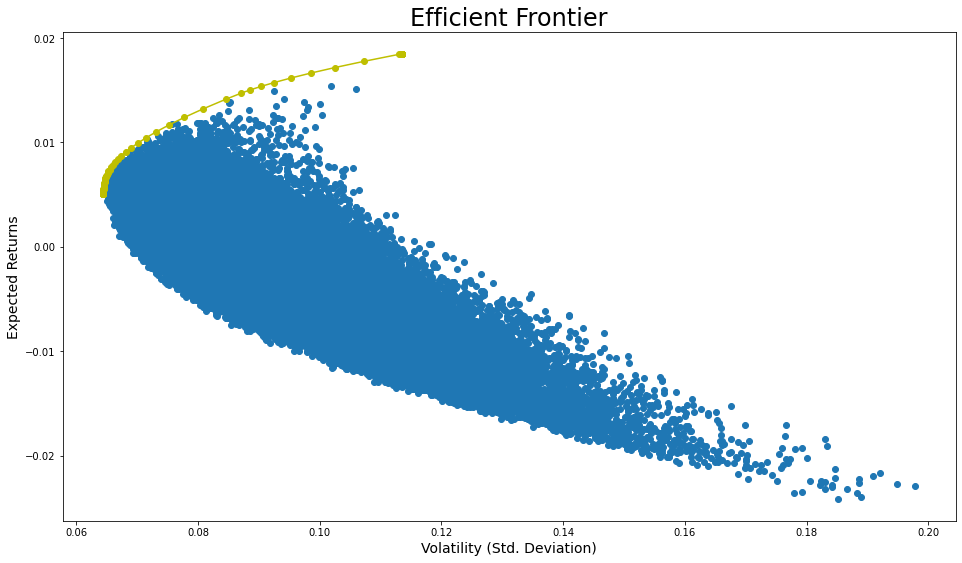

In [9]:
plt.figure(figsize=(16,9))
plt.scatter(random_portfolios['Volatility'], random_portfolios['Returns'])
plt.plot(risks, returns, 'y-o')
plt.ylabel('Expected Returns',fontsize=14)
plt.xlabel('Volatility (Std. Deviation)',fontsize=14)
plt.title('Efficient Frontier', fontsize=24)
plt.show()

## Task Two: `script2.py`

9. You inherited a portfolio with five assets, stored in `stock_data_weak.csv`:
    
    |Asset|Expected Return|
    |:----|:--------------|
    |General Electric|-0.0120|
    |Chesapeake Energy|-0.0306|
    |AT&T|-0.0014|
    |Cisco Systems|0.0184|
    |Campbell Soup|0.0084|
    
    Run `script2.py` to visualize the efficient frontier for these assets.

10. You decide to diversify the portfolio with a couple of assets to increase the expected return of portfolios on the efficient frontier.

    You choose to add Bank of America and Marvel, so your assets are:
    
    |Asset|Expected Return|
    |:----|:--------------|
    |General Electric|-0.0120|
    |Chesapeake Energy|-0.0306|
    |AT&T|-0.0014|
    |Cisco Systems|0.0184|
    |Campbell Soup|0.0084|
    |Bank of America|0.0341|
    |Marvel|0.0369|
    
    Change the path variable to `stock_data2.csv` to visualize this new efficient frontier.

11. It is hard to visualize how much the efficient frontier improved with these assets. Let us plot the original efficient frontier on the same figure. Use the following code to do this:
    ```
    weak_EF = pd.read_csv('weak_risks_returns.csv')
    plt.plot(weak_EF['Risks'], weak_EF['Returns'], 'g-o')
    ```
    To get a better view of the efficient frontier, you may want to comment out the following line:
    ```
    random_portfolios.plot.scatter(x='Volatility', y='Returns', fontsize=12)
    ```
    By adding the two high-return assets, we increased the expected return of portfolios on the efficient frontier.

12. If you look at the expected returns of assets in your portfolio, you will notice that General Electric and Chesapeake Energy have a large negative return (i.e. you expect to lose money).

    |Asset|Expected Return|
    |:----|:--------------|
    |General Electric|-0.0120|
    |Chesapeake Energy|-0.0306|
    |AT&T|-0.0014|
    |Cisco Systems|0.0184|
    |Campbell Soup|0.0084|
    |Bank of America|0.0341|
    |Marvel|0.0369|
    
    This begs the questions: do we need these assets in our portfolio? Given their poor expected return, we should only keep them if they are uniquely uncorrelated to the rest of the assets in the portfolio.
    
    To check the effects of these assets, we calculated the efficient frontier for a portfolio **without** General Electric and Chesapeake Energy. Add the following code to the bottom of `script2.py` to visualize this efficient frontier on the same  plot:
    ```
    strong_EF = pd.read_csv('strong_risks_returns.csv')
    plt.plot(strong_EF['Risks'], strong_EF['Returns'], 'k-x')
    ```
    What do you notice when you run the code?

*Hint: The efficient frontier did not change when you removed the two low return assets. Because these assets had low returns and were correlated to other assets in the portfolio, they did not improve the possible portfolios.*

## Task Three: `script3.py`

13. Next, you will use your understanding of expected returns and covariances to inform portfolio decisions. We have asset data for 10 stocks, stored in `stock_data3.csv`.

    Open `script3.py` and run the code.
    
    You should see two efficient frontiers. We calculate the better efficient frontier (green dots) using all ten assets. We calculate the other efficient frontier using only five assets from the portfolio.
    
    Your job is to choose five assets from the following list to create the best efficient frontier.
    ```
    ['PFE', 'TGT', 'M', 'VZ', 'JPM', 'MRO', 'KO', 'PG', 'CVS', 'HPQ']
    ```
    Use the expected returns and covariance table, and set the selected variable equal to a list with five of these assets.
    
    In the hint, we provide our best solution and explain how we arrived there.

*Hint: Using the following five assets will result in an efficient frontier that closely resembles a portfolio with all ten assets.*

`selected = ['TGT', 'CVS', 'M', 'VZ', 'JPM']`

*We used the following approach to select these assets:*

* *`JPM` has the largest expected return, so we knew to include it.*
* *We added the asset that was the least correlated to `JPM` – `VZ` has a small negative covariance.*
* *We selected the assets with the next three highest expected returns: `M`, `CVS`, and `TGT`.*